#### Импорт, необходимых библиотек

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import tensorflow as tf
from sklearn.model_selection import train_test_split, StratifiedKFold

#### Загрузка данных

In [ ]:
FD = 1000 # частота дискретизации
DUR = 100 # длительность стимуляции

# разметка по времени начала и окончания стимуляции
STIM = {'7': [[(7 * 60 + 2) * FD, (7 * 60 + 2 + DUR) * FD],
              [(41 * 60 + 25) * FD, (41 * 60 + 25 + DUR) * FD],
              [(49 * 60 + 18) * FD, (49 * 60 + 18 + DUR) * FD]],
        '9': [[(9 * 60 + 38) * FD, (9 * 60 + 38 + DUR) * FD],
              [(43 * 60 + 35) * FD, (43 * 60 + 35 + DUR) * FD],
              [(51 * 60 + 12) * FD, (51 * 60 + 12 + DUR) * FD]], 
        '11': [[(11 * 60 + 33) * FD, (11 * 60 + 33 + DUR) * FD],
               [(45 * 60 + 29) * FD, (45 * 60 + 29 + DUR) * FD],
               [(53 * 60 + 6) * FD, (53 * 60 + 6 + DUR) * FD]],
        '13': [[(13 * 60 + 27) * FD, (13 * 60 + 27 + DUR) * FD],
               [(47 * 60 + 24) * FD, (47 * 60 + 24 + DUR) * FD],
               [(55 * 60 + 13) * FD, (55 * 60 + 13 + DUR) * FD]]}

#  каналы, используемые для выявления SSVEP
CHANNELS = ['P3A1',	'P4A2',	'PzA1',	'O1A1',	'O2A2',	'OzA2']

filename = '/content/drive/MyDrive/ВКР/Деркач_21.05.21_data.txt'
data = pd.read_csv(filename, sep=' ')

# первая стимуляция
freq_7_1 = data.loc[STIM['7'][0][0]:STIM['7'][0][1], CHANNELS].reset_index(drop=True)[:-1]
freq_9_1 = data.loc[STIM['9'][0][0]:STIM['9'][0][1], CHANNELS].reset_index(drop=True)[:-1]
freq_11_1 = data.loc[STIM['11'][0][0]:STIM['11'][0][1], CHANNELS].reset_index(drop=True)[:-1]
freq_13_1 = data.loc[STIM['13'][0][0]:STIM['13'][0][1], CHANNELS].reset_index(drop=True)[:-1]

# вторая стимуляция
freq_7_2 = data.loc[STIM['7'][1][0]:STIM['7'][1][1], CHANNELS].reset_index(drop=True)[:-1]
freq_9_2 = data.loc[STIM['9'][1][0]:STIM['9'][1][1], CHANNELS].reset_index(drop=True)[:-1]
freq_11_2 = data.loc[STIM['11'][1][0]:STIM['11'][1][1], CHANNELS].reset_index(drop=True)[:-1]
freq_13_2 = data.loc[STIM['13'][1][0]:STIM['13'][1][1], CHANNELS].reset_index(drop=True)[:-1]

# третья стимуляция
freq_7_3 = data.loc[STIM['7'][2][0]:STIM['7'][2][1], CHANNELS].reset_index(drop=True)[:-1]
freq_9_3 = data.loc[STIM['9'][2][0]:STIM['9'][2][1], CHANNELS].reset_index(drop=True)[:-1]
freq_11_3 = data.loc[STIM['11'][2][0]:STIM['11'][2][1], CHANNELS].reset_index(drop=True)[:-1]
freq_13_3 = data.loc[STIM['13'][2][0]:STIM['13'][2][1], CHANNELS].reset_index(drop=True)[:-1]

# слияние всехданных по частотам
freq_7 = pd.concat([freq_7_1, freq_7_2, freq_7_3])
freq_9 = pd.concat([freq_9_1, freq_9_2, freq_9_3])
freq_11 = pd.concat([freq_11_1, freq_11_2, freq_11_3])
freq_13 = pd.concat([freq_13_1, freq_13_2, freq_13_3])

#### Просмотр таблиц для каждой стимуляции

In [ ]:
data

,Stim,Fp1A1,Fp2A2,FpzA2,F3A1,F4A2,FzA1,C3A1,C4A2,CzA2,P3A1,P4A2,PzA1,O1A1,O2A2,OzA2,F7A1,F8A2,T3A1,T4A2,T5A1,T6A2,Rs
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3415996,0,-11,-23,-13,-5,-13,-1,-3,-3,4,-6,-15,-5,-10,-14,-11,-9,-14,14,-8,-1,-19,0
3415997,0,-12,-24,-14,-5,-14,0,-3,-3,3,-6,-17,-5,-9,-16,-12,-8,-18,15,-8,-1,-21,0
3415998,0,-14,-25,-16,-6,-16,-1,-4,-4,2,-7,-18,-7,-10,-17,-12,-10,-23,14,-8,-1,-23,0
3415999,0,-15,-26,-16,-8,-16,-3,-6,-4,3,-9,-18,-8,-11,-17,-12,-11,-26,14,-7,-2,-22,0


In [ ]:
freq_7

,P3A1,P4A2,PzA1,O1A1,O2A2,OzA2
0,-30,-19,-35,-21,-6,-14
1,-32,-18,-38,-23,-5,-14
2,-34,-17,-40,-25,-5,-14
3,-36,-18,-41,-27,-5,-15
4,-36,-20,-41,-27,-7,-16
...,...,...,...,...,...,...
99995,6,7,7,7,11,2
99996,6,6,6,7,9,0
99997,6,4,6,6,7,-3
99998,6,3,7,6,5,-5


In [ ]:
freq_9

,P3A1,P4A2,PzA1,O1A1,O2A2,OzA2
0,1,-12,-5,2,4,-5
1,1,-14,-5,3,3,-7
2,1,-17,-6,3,2,-8
3,0,-19,-7,3,0,-9
4,-2,-22,-9,2,-1,-11
...,...,...,...,...,...,...
99995,-2,1,0,-13,-1,-8
99996,-2,2,0,-13,0,-7
99997,-1,2,2,-11,1,-6
99998,1,4,4,-10,2,-4


In [ ]:
freq_11

,P3A1,P4A2,PzA1,O1A1,O2A2,OzA2
0,12,12,9,9,10,10
1,11,14,9,9,12,12
2,11,14,9,8,13,12
3,10,13,8,8,12,11
4,9,11,8,7,10,10
...,...,...,...,...,...,...
99995,-7,7,-5,-3,7,4
99996,-6,7,-5,-3,7,5
99997,-6,6,-5,-3,7,5
99998,-5,5,-5,-2,7,4


In [ ]:
freq_13

,P3A1,P4A2,PzA1,O1A1,O2A2,OzA2
0,-7,-4,-9,-2,-1,2
1,-9,-5,-11,-4,-1,2
2,-11,-5,-13,-5,-1,3
3,-12,-6,-14,-6,-1,3
4,-13,-5,-15,-7,0,3
...,...,...,...,...,...,...
99995,-10,1,-7,-9,4,1
99996,-9,3,-7,-8,6,3
99997,-8,5,-6,-8,8,6
99998,-8,6,-6,-7,9,7


#### Функции

In [ ]:
# построение статичного графика
def plot_eeg(x):
    plt.figure(figsize=(12,8))
    plt.plot(x)

# построение интерактивного графика
def interactive_plot(signal):
    fig = go.Figure()
    for chan in CHANNELS:
        fig.add_trace(go.Scatter(x=list(range(len(signal[chan]))), y=signal[chan], name=chan))
    fig.show()

# построение БПФ для нескольких каналов для одной частоты стимуляции
def fft_multy(signal):
    fig = go.Figure()
    for chan in CHANNELS:
        fft = np.fft.fft(signal[chan])
        freq = np.arange(len(fft)) * FD / (len(fft) - 1)
        fig.add_trace(go.Scatter(x=freq, y=abs(fft), name=chan))

    fig.update_layout(xaxis=dict(range=[0,60]))
    fig.update_layout(title='FFT')
    fig.show()

# построение БПФ из мини-графиков для одного канала
# и для одной частоты
def range_fft(x, rows=5, cols=5):
    n_rows = rows
    n_cols = cols
    signal = np.array(x).reshape((n_rows * n_cols, len(x) // (n_rows * n_cols)))

    fig = make_subplots(rows=n_rows, cols=n_cols, vertical_spacing=0.07, horizontal_spacing=0.05)
    for num, array in enumerate(signal):
        fft = np.fft.rfft(array)
        freq = np.arange(len(fft)) * FD / (len(fft)-1) / 2

        i = ((num) // n_cols) + 1
        j = (num) - (i - 1) * n_cols + 1

        name = str(num * len(array) // FD) + '-' + str((num + 1) * len(array) // FD) + ' sec' 

        fig.add_trace(go.Scatter(x=freq, y=abs(fft), name=name), row=i, col=j)
        fig.update_xaxes(title='F, Hz', row=i, col=j, range=[0, 40])
        fig.update_yaxes(title='|A|', title_standoff = 6, row=i, col=j)

    fig.update_layout(title='Fast Fourier Transform', height=900, width=1800)
    fig.show()

# разбиение сигнала на окна регистрации
def get_windowed_data(data, window=2, Fd=1000, channels=6):
    length = len(data)
    windowed = np.array(data).reshape(length // (window * Fd), window * Fd, channels)
    return windowed
# применение БПФ для каждой серии сигнала по всем каналам
def get_fft_data(x):
    fft_data = None
    for signal in x:
        fft_chan = None
        for ch in range(6):
            fft = np.fft.rfft(signal[:, ch]).reshape(-1, 1)
            if fft_chan is None:
                fft_chan = fft[:60]
            else:
                fft_chan= np.hstack([fft_chan, fft[:60]])
        fft_chan = fft_chan.reshape(-1, fft_chan.shape[0], fft_chan.shape[1])
        if fft_data is None:
            fft_data = fft_chan
        else:
            fft_data = np.concatenate([fft_data, fft_chan])
        
    return abs(fft_data)

#### Визуализауия сигналов и их спектральных плотностей

In [ ]:
interactive_plot(freq_7[:10000])

In [ ]:
fft_multy(freq_7_3)

In [ ]:
range_fft(freq_9_3['OzA2'][:FD*96], 4, 4)

#### Предобрработка данных необработанного ЭЭГ

In [ ]:
window = 2
all_freq_7 = get_windowed_data(freq_7, window)
all_freq_9 = get_windowed_data(freq_9, window)
all_freq_11 = get_windowed_data(freq_11, window)
all_freq_13 = get_windowed_data(freq_13, window)

In [ ]:
print(f'Размер numpy массива с частотой стимуляции 7 Гц: {all_freq_7.shape}')
print(f'Размер numpy массива с частотой стимуляции 9 Гц: {all_freq_9.shape}')
print(f'Размер numpy массива с частотой стимуляции 11 Гц: {all_freq_11.shape}')
print(f'Размер numpy массива с частотой стимуляции 13 Гц: {all_freq_13.shape}')

Размер numpy массива с частотой стимуляции 7 Гц: (150, 2000, 6)
Размер numpy массива с частотой стимуляции 9 Гц: (150, 2000, 6)
Размер numpy массива с частотой стимуляции 11 Гц: (150, 2000, 6)
Размер numpy массива с частотой стимуляции 13 Гц: (150, 2000, 6)


In [ ]:
X = np.vstack((all_freq_7, all_freq_9, all_freq_11, all_freq_13))

# кодирование меток классов
# 7 Гц = label 0
# 9 Гц = label 1
# 11 Гц = label 2
# 13 Гц = label 3
y = np.array([0] * (X.shape[0] // 4) + [1] * (X.shape[0] // 4) + [2] * (X.shape[0] // 4) + [3] * (X.shape[0] // 4))

In [ ]:
print(f'Размерность тензора X: {X.shape}')
print(f'Размерность вектора y: {y.shape}')

Размерность тензора X: (600, 2000, 6)
Размерность вектора y: (600,)


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [ ]:
print(f'Размерность обущающей выборки: {X_train.shape}, и её меток: {y_train.shape}')
print(f'Размерность тестовой выборки: {X_test.shape}, и её меток: {y_test.shape}')

Размерность обущающей выборки: (480, 2000, 6), и её меток: (480,)
Размерность тестовой выборки: (120, 2000, 6), и её меток: (120,)


#### Преобработка данных БПФ

In [ ]:
window = 3
all_freq_7 = get_windowed_data(freq_7, window)
all_freq_9 = get_windowed_data(freq_9, window)
all_freq_11 = get_windowed_data(freq_11, window)
all_freq_13 = get_windowed_data(freq_13, window)

fft_7 = get_fft_data(all_freq_7)
fft_9 = get_fft_data(all_freq_9)
fft_11 = get_fft_data(all_freq_11)
fft_13 = get_fft_data(all_freq_13)

print(f'Размер numpy массива с частотой стимуляции 7 Гц: {fft_7.shape}')
print(f'Размер numpy массива с частотой стимуляции 9 Гц: {fft_9.shape}')
print(f'Размер numpy массива с частотой стимуляции 11 Гц: {fft_11.shape}')
print(f'Размер numpy массива с частотой стимуляции 13 Гц: {fft_13.shape}')

Размер numpy массива с частотой стимуляции 7 Гц: (100, 60, 6)
Размер numpy массива с частотой стимуляции 9 Гц: (100, 60, 6)
Размер numpy массива с частотой стимуляции 11 Гц: (100, 60, 6)
Размер numpy массива с частотой стимуляции 13 Гц: (100, 60, 6)


Text(0, 0.5, '|A|')

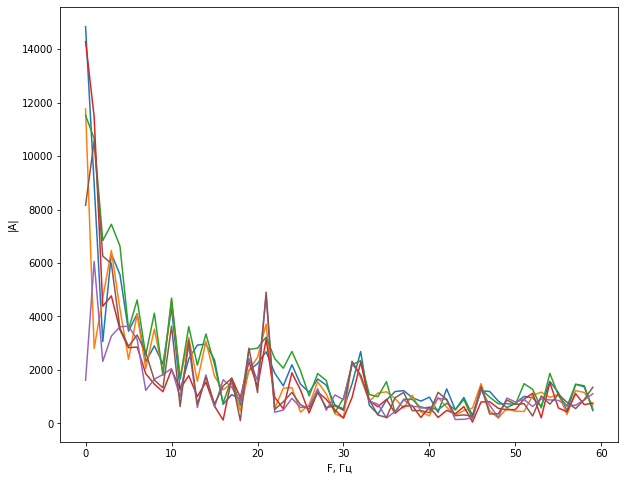

In [ ]:
plt.figure(figsize=(10,8))
plt.plot(fft_7[0])
plt.xlabel('F, Гц')
plt.ylabel('|A|')

In [ ]:
X = np.vstack((fft_7, fft_9, fft_11, fft_13))

# кодирование меток классов
# 7 Гц = label 0
# 9 Гц = label 1
# 11 Гц = label 2
# 13 Гц = label 3
y = np.array([0] * (X.shape[0] // 4) + [1] * (X.shape[0] // 4) + [2] * (X.shape[0] // 4) + [3] * (X.shape[0] // 4))

print(f'Размерность тензора X: {X.shape}')
print(f'Размерность вектора y: {y.shape}')

Размерность тензора X: (400, 37, 6)
Размерность вектора y: (400,)


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

print(f'Размерность обущающей выборки: {X_train.shape}, и её меток: {y_train.shape}')
print(f'Размерность тестовой выборки: {X_test.shape}, и её меток: {y_test.shape}')

Размерность обущающей выборки: (320, 37, 6), и её меток: (320,)
Размерность тестовой выборки: (80, 37, 6), и её меток: (80,)


#### Различные архитектуры нейросетей

In [ ]:
from keras.layers import Dense, Input, Dropout, Conv1D, Flatten, LSTM, BatchNormalization, MaxPooling1D, Bidirectional
from keras.models import Model

In [ ]:
def model_1():
    input_layer = Input(shape=X[0].shape)
    flatten = Flatten()(input_layer)
    output_layer = Dense(units=4, activation='softmax')(flatten)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

def model_2():
    input_layer = Input(shape=X[0].shape)
    flatten = Flatten()(input_layer)
    dense = Dense(units=100, activation='relu')(flatten)
    output_layer = Dense(units=4, activation='softmax')(dense)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

def model_3():
    input_layer = Input(shape=X[0].shape)
    flatten = Flatten()(input_layer)
    dense = Dense(units=200, activation='relu')(flatten)
    dense = Dense(units=100, activation='relu')(dense)
    output_layer = Dense(units=4, activation='softmax')(dense)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

def model_4():
    input_layer = Input(shape=X[0].shape)
    conv1 = Conv1D(filters=128, kernel_size=5, activation='relu')(input_layer)
    maxpool = MaxPooling1D(2)(conv1)
    flatten = Flatten()(maxpool)
    dense = Dense(units=100, activation='relu')(flatten)
    output_layer = Dense(units=4, activation='softmax')(dense)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

def model_5():
    input_layer = Input(shape=X[0].shape)
    conv1 = Conv1D(filters=128, kernel_size=5, activation='relu')(input_layer)
    maxpool = MaxPooling1D(2)(conv1)
    conv1 = Conv1D(filters=64, kernel_size=2, activation='relu')(maxpool)
    maxpool = MaxPooling1D(2)(conv1)
    flatten = Flatten()(maxpool)
    dense = Dense(units=200, activation='relu')(flatten)
    output_layer = Dense(units=4, activation='softmax')(dense)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

def model_6():
    input_layer = Input(shape=X[0].shape)
    conv1 = Conv1D(filters=128, kernel_size=5, activation='relu')(input_layer)
    maxpool = MaxPooling1D(2)(conv1)
    conv1 = Conv1D(filters=64, kernel_size=2, activation='relu')(maxpool)
    maxpool = MaxPooling1D(2)(conv1)
    conv1 = Conv1D(filters=32, kernel_size=2, activation='relu')(maxpool)
    flatten = Flatten()(conv1)
    dense = Dense(units=200, activation='relu')(flatten)
    output_layer = Dense(units=4, activation='softmax')(dense)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

def model_7():
    input_layer = Input(shape=X[0].shape)
    conv1 = Conv1D(filters=128, kernel_size=5, activation='relu')(input_layer)
    maxpool = MaxPooling1D(2)(conv1)
    lstm = LSTM(128, return_sequences=True)(maxpool)
    flatten = Flatten()(lstm)
    dense = Dense(units=50, activation='relu')(flatten)
    output_layer = Dense(units=4, activation='softmax')(dense)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

def model_8():
    input_layer = Input(shape=X[0].shape)
    conv1 = Conv1D(filters=128, kernel_size=5, activation='relu')(input_layer)
    maxpool = MaxPooling1D(2)(conv1)
    conv1 = Conv1D(filters=64, kernel_size=2, activation='relu')(maxpool)
    lstm = LSTM(128, return_sequences=True)(conv1)
    lstm = LSTM(64, return_sequences=True)(lstm)
    flatten = Flatten()(lstm)
    dense = Dense(units=200, activation='relu')(flatten)
    do = Dropout(0.2)(dense)
    dense = Dense(units=50, activation='relu')(do)
    output_layer = Dense(units=4, activation='softmax')(dense)

    model = Model(input_layer, output_layer)
    model.compile(loss='sparse_categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model


### Проверка TSNE

In [ ]:
from matplotlib.colors import Normalize
from sklearn.manifold import TSNE
tsne = TSNE(n_components=3, n_iter=400)

X_tsne_3 = tsne.fit_transform(X.reshape((600,-1)))

'''
plt.figure(figsize=(20, 12))
for d in range(4):
    norm = Normalize(vmin=0, vmax=4)
    color = plt.cm.gist_ncar(norm(d))
    plt.scatter(X_tsne_2[:, 0][y == d],
                X_tsne_2[:, 1][y == d],
                c=[color] * len(X_tsne_2[:, 0][y == d]), label=d, edgecolor='none', s=50)
plt.title(u"Уменьшение размерности методом tSNE", fontsize=20)
plt.legend()

fig = go.Figure()
for i in CHANNELS:
    fig.add_trace(go.Scatter(x=list(range(len(x[i]))), y=x[i], name=i))
fig.show()
'''


import plotly.express as px

'''
fig = px.scatter_3d(x=X_tsne_3[:,0][y == 0], y=X_tsne_3[:,1][y == 0], z=X_tsne_3[:,2][y == 0])
fig = px.scatter_3d(x=X_tsne_3[:,0][y == 1], y=X_tsne_3[:,1][y == 2], z=X_tsne_3[:,2][y == 3])
fig.show()'''


fig = go.Figure()
for i in range(4):
    fig.add_trace(go.Scatter3d(x=X_tsne_3[:,0][y == i], y=X_tsne_3[:,1][y == i], z=X_tsne_3[:,2][y == i]))
fig.show()

###Обучение модели

In [ ]:
model = model_8()

model.summary()
history = model.fit(X_train, y_train, epochs=40, validation_data=(X_test, y_test))

print('Evaluation of model:')
print(model.evaluate(X_test, y_test))

Model: "model_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_22 (InputLayer)        [(None, 37, 6)]           0         
_________________________________________________________________
conv1d_25 (Conv1D)           (None, 33, 128)           3968      
_________________________________________________________________
max_pooling1d_13 (MaxPooling (None, 16, 128)           0         
_________________________________________________________________
conv1d_26 (Conv1D)           (None, 15, 64)            16448     
_________________________________________________________________
lstm_24 (LSTM)               (None, 15, 128)           98816     
_________________________________________________________________
lstm_25 (LSTM)               (None, 15, 64)            49408     
_________________________________________________________________
flatten_21 (Flatten)         (None, 960)               0  

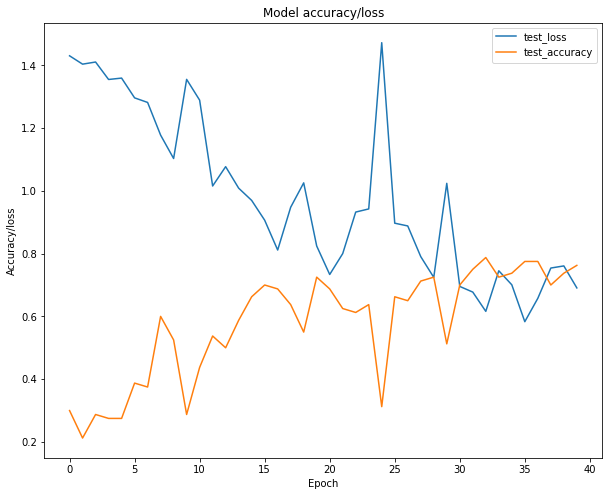

In [ ]:
plt.figure(figsize=(10,8))
plt.plot(history.history['val_loss'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy/loss')
plt.ylabel('Accuracy/loss')
plt.xlabel('Epoch')
plt.legend(['test_loss', 'test_accuracy'], loc='upper right')
plt.show()

In [ ]:
mean_acc = []
mean_loss = []

kFold = StratifiedKFold(n_splits=5)
for train, test in kFold.split(X, y):
    model = None
    model = model_1()
    model.fit(X[train], y[train], epochs=20, verbose=2)
    mean_acc.append(model.evaluate(X[test], y[test])[1])
    mean_loss.append(model.evaluate(X[test], y[test])[0])

print('accuracy: ', np.array(mean_acc).mean())
print('loss: ', np.array(mean_loss).mean())